In [7]:
import pandas as pd
import os
import sys
sys.path.append("..") # Adds higher directory to python modules path.
from src.constants import *
import folium
import IPython
from folium.plugins import HeatMap
import glob
from folium.plugins import HeatMapWithTime
from jinja2 import Template
from folium.map import Layer
from tqdm.auto import tqdm

In [233]:

def generateBaseMap(default_location=[46.900, 8.4375], default_zoom_start=5):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start, tiles ="https://api.mapbox.com/styles/v1/tigerflystudio/ckf9pjhvp1naa19rwl43ahilz/tiles/256/{z}/{x}/{y}@2x?access_token=pk.eyJ1IjoidGlnZXJmbHlzdHVkaW8iLCJhIjoiY2tmOW94a3kzMG83ZTJybWFqc28ydDI1NyJ9.uoRh84Gv3y9J397hMz-BDw",
           attr='Mapbox Control Room')
    return base_map

In [10]:
#LOAD AND CLEAN COVID DATA
df = pd.read_csv(os.path.join(DATA_PATH, "Bing-COVID-19-Data", "data", "Bing-COVID19-Data.csv")).fillna(0)
df_covid_copy = df[df.Country_Region != "Worldwide"].copy()
df_covid_copy = df_covid_copy[['Updated','Latitude', 'Longitude', 'ConfirmedChange']]
df_covid_copy["Updated"] = pd.to_datetime(df.Updated)
df_covid_copy = df_covid_copy[df_covid_copy.Updated < "2020-06-08"]

In [11]:
#LOAD AND AGGREGATE TWITTER DATA
geo_tweets_file, place_tweets_file = glob.glob(TWITTER_PATH + "/*.csv")
geo_tweets = pd.read_csv(geo_tweets_file)
place_tweets = pd.read_csv(place_tweets_file)
place_tweets = place_tweets.rename(columns={"estimated_longitude": "Longitude", "estimated_latitude": "Latitude", "created_at": "Updated"})
geo_tweets = geo_tweets.rename(columns={"longitude": "Longitude", "latitude": "Latitude", "created_at": "Updated"})
all_tweets = pd.concat([place_tweets, geo_tweets])
all_tweets = all_tweets[['Updated', 'Longitude', 'Latitude']]
all_tweets["Updated"] = pd.to_datetime(all_tweets.Updated)
all_tweets_copy = all_tweets.copy()
#to have same time scale as covid data
all_tweets_copy = all_tweets_copy[all_tweets_copy.Updated > pd.to_datetime("2020-01-20")]


In [147]:
media_data=pd.read_csv(os.path.join(DATA_PATH,"srf_data/processed/processed_lat_and_long.csv"))[["pubDateTime", "lattitude", "longitude"]]

In [148]:
media_data

,pubDateTime,lattitude,longitude
0,2020-02-20 00:00:00+00:00,47.57117,8.65006
1,2020-02-20 00:00:00+00:00,47.40711,8.46276
2,2020-02-20 00:00:00+00:00,47.42840,7.12621
3,2020-02-20 00:00:00+00:00,47.59893,8.64373
4,2020-02-20 00:00:00+00:00,47.42840,7.12621
...,...,...,...
108394,2020-04-08 13:37:00+00:00,47.37499,8.08380
108395,2020-05-07 15:01:00+00:00,47.37499,8.08380
108396,2020-05-05 11:11:03+00:00,46.99087,6.79767
108397,2020-04-26 08:31:00+00:00,47.15886,8.53866


In [237]:
#LOAD AND AGGREGATE MEDIA DATA
media_data = media_data.rename(columns={"longitude": "Longitude", "lattitude": "Latitude", "pubDateTime": "Updated"})
media_data["Updated"] = pd.to_datetime(media_data.Updated)
media_data = media_data.copy()
#to have same time scale as covid data
media_data = media_data[(media_data.Updated > "2020-01-20")&(media_data.Updated < "2020-06-08")]


In [238]:
media_data["Updated"] = media_data.Updated.dt.date

In [239]:
base_map = generateBaseMap(default_zoom_start=8)

In [240]:
#MEDIA OVER TIME
df_date_list_media = []
for date in tqdm(media_data.Updated.sort_values().unique()):
    df_date_list_media.append(media_data.loc[media_data.Updated == date, ['Latitude', 'Longitude']].groupby(['Latitude', 'Longitude']).sum().reset_index().values.tolist())
    

In [241]:
#hmap_time_twitter=HeatMapWithTime(df_date_list, radius=20, min_opacity = 0.5, gradient ={0.2: 'lightsteelblue', 0.5: 'cornflowerblue', 0.7: 'royalblue', 1.0: 'navy'}, max_opacity=0.8, use_local_extrema=True, overlay=True).add_to(base_map)
hmap_time_media = HeatMapWithTime(df_date_list_media,overlay=True,name='Media',min_opacity=0.05,radius=20,max_opacity=1, gradient ={0.2: 'lawngreen', 0.5: 'limegreen', 0.7: 'green', 1.0: 'darkgreen'}).add_to(base_map)
base_map.add_child(hmap_time_media)


In [125]:
base_map = generateBaseMap()

In [126]:
#COVID CASES OVER TIME
df_date_list_cov = []
for date in df_covid_copy.Updated.sort_values().unique():
    df_date_list_cov.append(df_covid_copy.loc[df_covid_copy.Updated == date, ['Latitude', 'Longitude', 'ConfirmedChange']].groupby(['Latitude', 'Longitude']).sum().reset_index().values.tolist())


In [160]:
#TWITTER CASES OVER TIME
df_date_list = []
for date in tqdm(all_tweets_copy.Updated.sort_values().unique()):
    df_date_list.append(all_tweets_copy.loc[all_tweets_copy.Updated == date, ['Latitude', 'Longitude']].groupby(['Latitude', 'Longitude']).sum().reset_index().values.tolist())

In [242]:
#hmap_time_twitter=HeatMapWithTime(df_date_list, radius=20, min_opacity = 0.5, gradient ={0.2: 'lightsteelblue', 0.5: 'cornflowerblue', 0.7: 'royalblue', 1.0: 'navy'}, max_opacity=0.8, use_local_extrema=True, overlay=True).add_to(base_map)
hmap_time_twitter = HeatMapWithTime(df_date_list,overlay=True,name='Twitter',min_opacity=0.05,radius=20,max_opacity=1, gradient ={0.2: 'lightsteelblue', 0.5: 'cornflowerblue', 0.7: 'royalblue', 1.0: 'navy'}).add_to(base_map)


In [243]:
#ADD TO MAP
base_map.add_child(hmap_time_twitter)


In [130]:
base_map = generateBaseMap()
hmap_time_covid=HeatMapWithTime(df_date_list_cov, radius=20, min_opacity = 0.5, gradient ={0.2: 'yellow', 0.5: 'gold', 0.8: 'orange', 1.0: 'red'}, max_opacity=0.8, use_local_extrema=True, overlay=False, name="Covid").add_to(base_map)
base_map.add_child(hmap_time_covid)

In [131]:
#LOAD AND CLEAN COVID DATA
import joblib
scare_twitter = joblib.load(os.path.join(DATA_PATH,"Twitter_Scare_Score.joblib")).copy()

In [88]:
scare_twitter

,count
Updated,
2020-01-18,0.133929
2020-01-20,0.178571
2020-01-21,0.267857
2020-01-22,0.327381
2020-01-23,0.491071
...,...
2020-06-03,2.410714
2020-06-04,2.306548
2020-06-05,2.380952


In [89]:
scare_twitter.index

DatetimeIndex(['2020-01-18', '2020-01-20', '2020-01-21', '2020-01-22',
               '2020-01-23', '2020-01-24', '2020-01-25', '2020-01-26',
               '2020-01-27', '2020-01-28',
               ...
               '2020-05-29', '2020-05-30', '2020-05-31', '2020-06-01',
               '2020-06-02', '2020-06-03', '2020-06-04', '2020-06-05',
               '2020-06-06', '2020-06-07'],
              dtype='datetime64[ns]', name='Updated', length=141, freq=None)

In [104]:
scare_media = pd.read_csv(os.path.join(DATA_PATH,"srf_data/processed/Swiss_media_score.csv"))


In [105]:
scare_media.pubDateTime = pd.to_datetime(scare_media.pubDateTime)
scare_media = scare_media[(scare_media["pubDateTime"] > "2020-01-20") & (scare_media["pubDateTime"] < "2020-06-08")]


In [118]:
plot_data = scare_media[["pubDateTime", "Media_Score"]]
plot_data= plot_data.set_index("pubDateTime")

<AxesSubplot:xlabel='pubDateTime'>

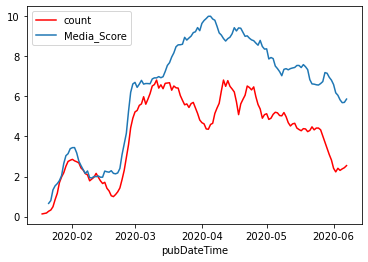

In [121]:
import seaborn as sns
ax = sns.lineplot(data =scare_twitter, palette=['red'])
sns.lineplot(data = plot_data, ax=ax)

In [111]:
sns.lineplot(data = plot_data, ax=ax)

<AxesSubplot:xlabel='pubDateTime'>

In [244]:
joblib.dump(df_date_list, os.path.join(DATA_PATH,"TWITTER_DATA.joblib"))

['/mnt/data/TWITTER_DATA.joblib']

In [245]:
joblib.dump(df_date_list_cov, os.path.join(DATA_PATH,"COVID_DATA.joblib"))

['/mnt/data/COVID_DATA.joblib']

In [246]:
joblib.dump(df_date_list_media, os.path.join(DATA_PATH,"MEDIA_DATA.joblib"))

['/mnt/data/MEDIA_DATA.joblib']